# Random forest
Training a random forest purely on the features profieded

In [3]:
from load_csv import load_csv_features
import pandas as pd
trainData, trainTarget, valData, valLabels = load_csv_features()
trainData.head()

,actin.s.area,actin.s.perimeter,actin.s.radius.mean,actin.s.radius.sd,actin.s.radius.min,actin.s.radius.max,actin.b.mean,actin.b.sd,actin.b.mad,actin.b.q005,...,DNA.h.sen.s3,DNA.h.ent.s3,DNA.h.dva.s3,DNA.h.den.s3,DNA.h.f12.s3,DNA.h.f13.s3,dist.10.nn,dist.20.nn,dist.30.nn,nuclear.displacement
25535,0.015415,0.097948,0.119467,0.094333,0.137140,0.111499,0.175873,0.078243,0.061116,0.172074,...,0.0,0.0,0.0,0.0,0.0,0.0,0.083050,0.091101,0.097196,0.020164
42206,0.050337,0.180970,0.217615,0.178592,0.240402,0.218555,0.180451,0.060682,0.040197,0.159181,...,0.0,0.0,0.0,0.0,0.0,0.0,0.106231,0.144258,0.158105,0.066014
990,0.044287,0.198694,0.195753,0.184669,0.123583,0.179242,0.211442,0.112281,0.071370,0.178976,...,0.0,0.0,0.0,0.0,0.0,0.0,0.239724,0.318913,0.326728,0.034786
9337,0.002196,0.037313,0.044434,0.059352,0.029521,0.049425,0.175882,0.094351,0.106645,0.135613,...,0.0,0.0,0.0,0.0,0.0,0.0,0.397892,0.503309,0.503735,0.017588
44955,0.039852,0.159515,0.190545,0.151414,0.222535,0.181675,0.251598,0.238287,0.208368,0.080367,...,0.0,0.0,0.0,0.0,0.0,0.0,0.098748,0.105288,0.108665,0.013408


In [4]:
import os
outputResults = os.path.join("outputs", "PCARandomForest.csv")

# reduce dimensions

In [5]:
from sklearn.decomposition import PCA
pca = PCA()
pcaTrain = pca.fit_transform(trainData)
pcaTrain = pd.DataFrame(pcaTrain)
pcaTrain.head()

,0,1,2,3,4,5,6,7,8,9,...,106,107,108,109,110,111,112,113,114,115
0,0.169308,-0.029438,-0.472230,0.352007,-0.468138,-0.212389,-0.113925,-0.018183,0.049079,-0.111807,...,-3.002920e-17,-2.800657e-17,-4.276117e-17,-2.366160e-17,2.151387e-17,-5.257334e-17,1.027078e-16,-1.772361e-17,4.295063e-17,-8.040953e-18
1,1.240507,-0.069424,0.004378,0.240015,-0.394456,0.044907,-0.067393,0.027911,-0.086458,-0.124581,...,-2.740069e-17,-2.042770e-17,3.196840e-17,1.163366e-17,-6.281393e-17,-2.536761e-17,-1.200024e-16,-6.829618e-17,6.742372e-17,1.292624e-17
2,0.964172,-0.060155,0.070522,0.476412,-0.444849,0.080504,-0.053784,0.117010,-0.323356,0.166711,...,4.351021e-18,-4.501013e-17,7.034894e-17,4.690045e-17,3.316998e-17,5.815447e-17,1.360699e-16,2.624295e-17,6.483242e-17,-1.407144e-17
3,0.024854,0.084825,-0.054838,0.077465,-0.768150,0.109004,-0.061271,0.557099,-0.190286,-0.107254,...,-1.197793e-17,-9.865822e-18,2.985549e-17,-1.207784e-16,2.110592e-17,-9.490650e-17,-1.450733e-16,-4.930483e-17,3.049783e-17,-8.329417e-18
4,-0.383666,-0.147163,0.077982,-0.308502,0.452784,-0.061949,0.110144,-0.146986,-0.043414,0.104230,...,-3.170732e-17,-1.013026e-16,1.808285e-17,8.534488e-18,-7.247369e-18,-5.872502e-17,-2.618814e-17,-2.580473e-17,-3.763467e-17,-1.998893e-19


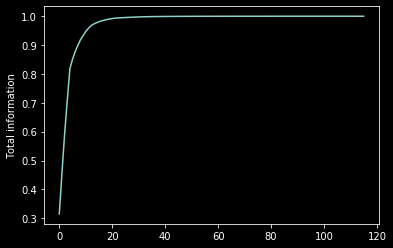

With 25 features the total information is 0.9955935302531056


In [6]:
pcaVarianceRatio = pca.explained_variance_ratio_
totalInfo = [pcaVarianceRatio[0]]
for i in range(1, len(pcaVarianceRatio)):
    totalInfo.append(totalInfo[i-1] + pcaVarianceRatio[i])

import matplotlib.pyplot as plt
plt.plot(totalInfo)
plt.ylabel('Total information')
plt.show()

numFeatures = 25
print(f"With {numFeatures} features the total information is {totalInfo[numFeatures]}")

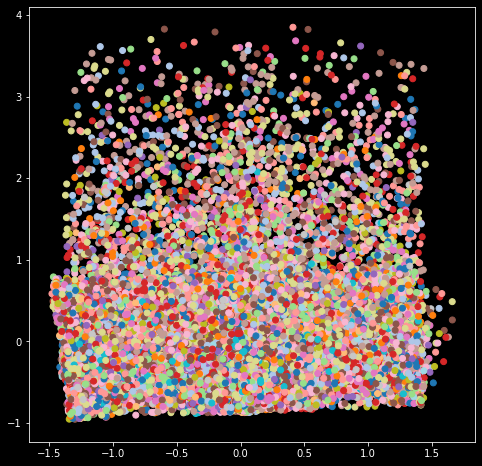

In [21]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

allUniqueLabels = np.unique(trainTarget)
label = []

fig = plt.figure(figsize=(8,8))
plt.scatter(pcaTrain[0], pcaTrain[1] , c=numTargets, cmap='tab20')

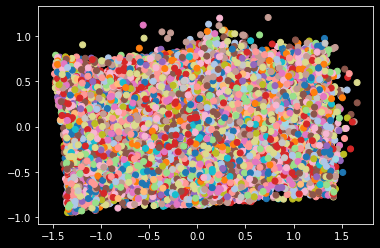

In [22]:
plt.scatter(pcaTrain[2], pcaTrain[3] , c=numTargets, cmap='tab20')

In [17]:
nameTargets = np.array(trainTarget)
numTargets = []
allNames = sorted(np.unique(nameTargets))
for name in nameTargets:
    numTargets.append(np.argmax([name == n for n in  allNames]))

In [17]:
pcaValidation = pca.transform(valData)
pcaValidation = pd.DataFrame(pcaValidation)
pcaValidation.head()

,0,1,2,3,4,5,6,7,8,9,...,106,107,108,109,110,111,112,113,114,115
0,-0.856920,0.146466,-0.018970,-0.119527,-0.600864,0.418187,0.037135,-0.043400,-0.123927,0.114043,...,1.710449e-16,3.155750e-17,-1.051160e-17,-5.679795e-18,-1.479935e-18,7.365967e-18,-6.262741e-19,1.209064e-17,-8.810691e-18,-1.377490e-17
1,-1.002629,0.029081,-0.141130,0.177926,-0.566343,0.039615,-0.045914,0.046194,0.057183,-0.181493,...,-8.593971e-18,2.856895e-17,-1.719642e-17,-6.228384e-18,5.489495e-18,1.247506e-18,-8.816981e-18,-1.430455e-18,-2.551906e-18,3.766350e-17
2,-0.620309,-0.327641,-0.261660,0.569344,0.259120,-0.041280,-0.067837,0.041616,0.016145,-0.109749,...,-1.610644e-16,1.771520e-17,-4.270251e-18,-6.957146e-18,5.603330e-18,-3.330122e-18,-6.160210e-18,-6.650454e-18,-6.325049e-19,1.745202e-17
3,0.386752,-0.549694,0.947725,0.199890,0.480812,-0.564322,-0.228799,0.071912,-0.363863,0.053777,...,-1.292196e-16,-6.758377e-18,-5.939808e-18,-3.333124e-18,-1.309519e-17,9.955116e-18,5.943221e-18,-2.317381e-18,1.822335e-17,-8.670344e-18
4,-0.720813,-0.392947,0.600612,-0.334938,0.584665,-0.021321,-0.097356,0.038880,0.021895,-0.094266,...,-4.320100e-17,1.438936e-17,-5.616174e-19,-1.144653e-17,-4.850324e-18,-3.789061e-19,1.255042e-18,-5.588947e-18,1.016461e-17,9.640256e-18


# Training Model

In [30]:
import numpy as np
from sklearn.ensemble import RandomForestClassifier
RFclf2 = RandomForestClassifier(n_estimators=1000, max_depth=15,
                             random_state=None)
X = np.array(pcaTrain[range(numFeatures)])
Y = np.array(trainTarget)
RFclf2.fit(X, Y)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=7, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=1000,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

# Validating

In [33]:
predictionsRF = RFclf2.predict(pcaValidation[range(numFeatures)])

In [34]:
allCodes = np.array(valLabels)
with open(outputResults, 'w') as file:
    file.write("cell_code,prediction\n")
    for p, code in zip(predictionsRF, allCodes):
        file.write(f"{code},{p}\n")